<a href="https://colab.research.google.com/github/VinamraGuptaa/Stock-Price-Prediction-Webapp/blob/main/Stock_Price_Prediction.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Stock Price Prediction

## Imports

In [ ]:
!pip install yfinance

     |████████████████████████████████| 6.3 MB 8.0 MB/s 
  Created wheel for yfinance: filename=yfinance-0.1.63-py2.py3-none-any.whl size=23918 sha256=e2269a0e629bcc2c2981ae25a29ccd8130a4174a3080284af2160cea7b3a19ca
  Stored in directory: /root/.cache/pip/wheels/fe/87/8b/7ec24486e001d3926537f5f7801f57a74d181be25b11157983
Successfully built yfinance
  Attempting uninstall: lxml
    Found existing installation: lxml 4.2.6
    Uninstalling lxml-4.2.6:
      Successfully uninstalled lxml-4.2.6


In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import yfinance as yf
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots
from fbprophet import Prophet
from fbprophet.plot import plot_plotly



ModuleNotFoundError: ignored

### Importing stocks from yahoo finance using the stock tickers

In [ ]:
tcs_tick=yf.Ticker("TCS.NS")
ril_tick=yf.Ticker("RELIANCE.NS")
bank_tick=yf.Ticker("ICICIBANK.NS")
bajfin_tick=yf.Ticker("BAJFINANCE.NS")
airtel_tick=yf.Ticker("BHARTIARTL.NS")

In [ ]:
tcs=tcs_tick.history(period="max")
ril=ril_tick.history(period="max")
bank=bank_tick.history(period="max")
bajfin=bajfin_tick.history(period="max")
artl=airtel_tick.history(period="max")

In [ ]:
tcs.head()

,Open,High,Low,Close,Volume,Dividends,Stock Splits
Date,,,,,,,
2002-08-12,28.794172,29.742206,28.794172,29.519140,212976,0.0,0.0
2002-08-13,29.556316,30.030333,28.905705,29.119476,153576,0.0,0.0
2002-08-14,29.184536,29.184536,26.563503,27.111877,822776,0.0,0.0
2002-08-15,27.111877,27.111877,27.111877,27.111877,0,0.0,0.0
2002-08-16,26.972458,28.255089,26.582090,27.046812,811856,0.0,0.0


In [ ]:
ril.head()

,Open,High,Low,Close,Volume,Dividends,Stock Splits
Date,,,,,,,
1996-01-01,10.471228,10.527415,10.402271,10.509538,48051995,0.0,0.0
1996-01-02,10.483999,10.535078,10.351193,10.427812,77875009,0.0,0.0
1996-01-03,10.598927,11.081625,10.483999,10.506985,96602936,0.0,0.0
1996-01-04,10.407379,10.440581,10.269465,10.409933,100099436,0.0,0.0
1996-01-05,10.369069,10.369069,10.249032,10.338421,76935930,0.0,0.0


In [ ]:
bank.head()

,Open,High,Low,Close,Volume,Dividends,Stock Splits
Date,,,,,,,
2002-07-01,18.504252,18.795449,18.067456,18.292473,2047540,0.0,0.0
2002-07-02,18.530722,20.119069,18.371887,19.470495,5546354,0.0,0.0
2002-07-03,19.457259,20.516158,19.397696,20.449976,5745267,0.0,0.0
2002-07-04,20.516158,20.966189,19.682275,19.940382,3896601,0.0,0.0
2002-07-05,19.721978,20.284518,19.616088,20.145538,3261038,0.0,0.0


In [ ]:
bajfin.head()

,Open,High,Low,Close,Volume,Dividends,Stock Splits
Date,,,,,,,
2002-07-01,3.873412,4.096063,3.873412,4.001257,21923,0.0,0.0
2002-07-02,4.083135,4.093190,4.007721,4.024240,61044,0.0,0.0
2002-07-03,4.070205,4.099653,3.938770,4.040759,34160,0.0,0.0
2002-07-04,4.066615,4.119046,4.004848,4.086726,27892,0.0,0.0
2002-07-05,4.112584,4.181534,4.047225,4.132694,58976,0.0,0.0


### Adding a Date column in all the dataframe

In [ ]:
tcs["Date"]=tcs.index
ril["Date"]=ril.index
bank["Date"]=bank.index
bajfin["Date"]=bajfin.index
artl["Date"]=artl.index

#### Shifting a value in Close column to get a everyday return from the stock 

In [ ]:
tcs['daily_return'] = (tcs['Close']/ tcs['Close'].shift(1)) -1
ril["daily_return"] = (ril["Close"]/ ril["Close"].shift(1)) -1
bank["daily_return"] = (bank["Close"]/ bank["Close"].shift(1)) -1
bajfin["daily_return"] = (bajfin["Close"]/ bajfin["Close"].shift(1)) -1
artl["daily_return"] = (artl["Close"]/ artl["Close"].shift(1)) -1


In [ ]:
fig = make_subplots(rows=2, cols=3)
plt.figure
fig.add_trace(
   go.Scatter(y=tcs.Close,x=tcs.Date,name="TCS"),
    row=1, col=1
)

fig.add_trace(
    go.Scatter(y=ril.Close,x=ril.Date,name="RIL"),
    row=1, col=2
)
fig.add_trace(
    go.Scatter(y=bank.Close,x=bank.Date,name="ICICI"),
    row=2, col=1
)
fig.add_trace(
    go.Scatter(y=bajfin.Close,x=bajfin.Date,name="Bajaj_fin"),
    row=2,col=2
)


fig.update_layout(height=600, width=900, title_text="Closing Price of different stocks throughout the year")
fig.show()

#### We can see a sharp drop in close price when covid-19 hit in march 2020. Since then the price of all the stocks has increased significantly.

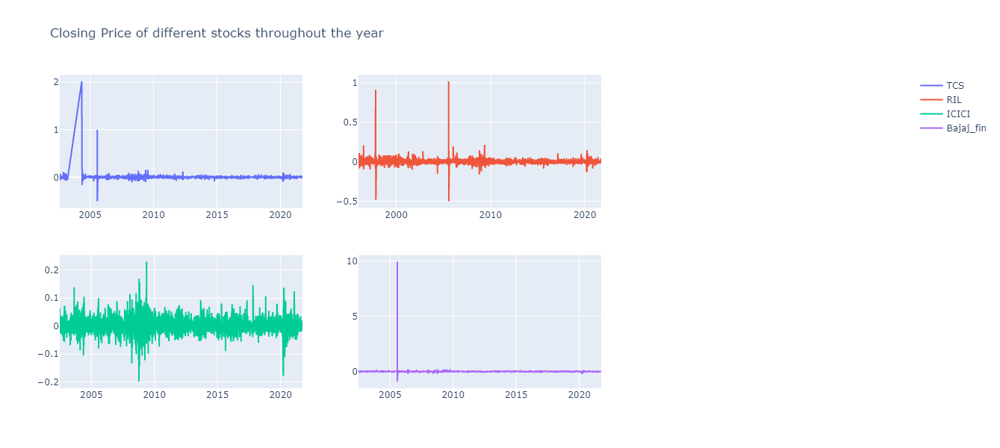

In [ ]:
fig = make_subplots(rows=2, cols=3)

fig.add_trace(
   go.Scatter(y=tcs.daily_return,x=tcs.Date,name="TCS"),
    row=1, col=1
)

fig.add_trace(
    go.Scatter(y=ril.daily_return,x=ril.Date,name="RIL"),
    row=1, col=2
)
fig.add_trace(
    go.Scatter(y=bank.daily_return,x=bank.Date,name="ICICI"),
    row=2, col=1
)
fig.add_trace(
    go.Scatter(y=bajfin.daily_return,x=bajfin.Date,name="Bajaj_fin"),
    row=2,col=2
)


fig.update_layout(height=600, width=900, title_text="Daily returns of different stocks")
fig.show()

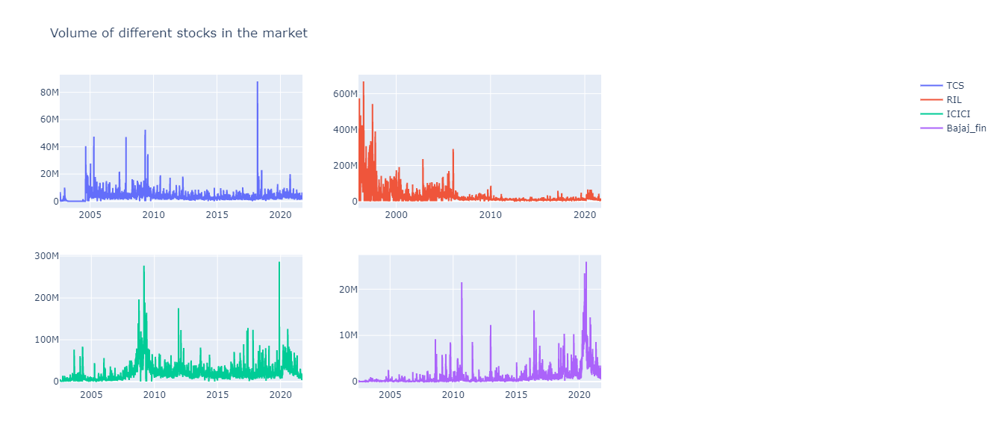

In [ ]:
fig = make_subplots(rows=2, cols=2)

fig.add_trace(
   go.Scatter(y=tcs.Volume,x=tcs.Date,name="TCS"),
    row=1, col=1
)

fig.add_trace(
    go.Scatter(y=ril.Volume,x=ril.Date,name="RIL"),
    row=1, col=2
)
fig.add_trace(
    go.Scatter(y=bank.Volume,x=bank.Date,name="ICICI"),
    row=2, col=1
)
fig.add_trace(
    go.Scatter(y=bajfin.Volume,x=bajfin.Date,name="Bajaj_fin"),
    row=2,col=2
)


fig.update_layout(height=600, width=900, title_text="Volume of different stocks in the market")
fig.show()

#### Market Capitalisation

In [ ]:
tcs["MarketCap"]=tcs["Open"]*tcs["Volume"]
ril["MarketCap"]=ril["Open"]*ril["Volume"]
bank["MarketCap"]=bank["Open"]*bank["Volume"]
bajfin["MarketCap"]=bajfin["Open"]*bajfin["Volume"]

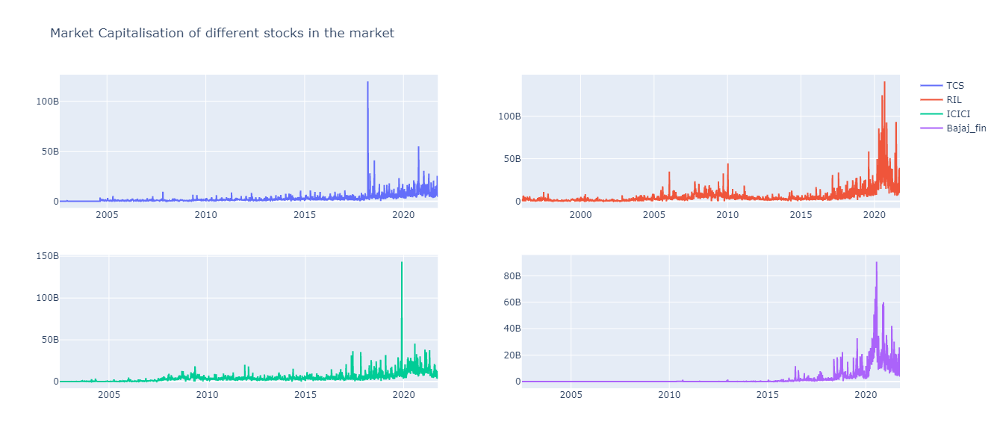

In [ ]:
fig = make_subplots(rows=2, cols=2)

fig.add_trace(
   go.Scatter(y=tcs.MarketCap,x=tcs.Date,name="TCS"),
    row=1, col=1
)

fig.add_trace(
    go.Scatter(y=ril.MarketCap,x=ril.Date,name="RIL"),
    row=1, col=2
)
fig.add_trace(
    go.Scatter(y=bank.MarketCap,x=bank.Date,name="ICICI"),
    row=2, col=1
)
fig.add_trace(
    go.Scatter(y=bajfin.MarketCap,x=bajfin.Date,name="Bajaj_fin"),
    row=2,col=2
)


fig.update_layout(height=600, width=900, title_text="Market Capitalisation of different stocks in the market")
fig.show()

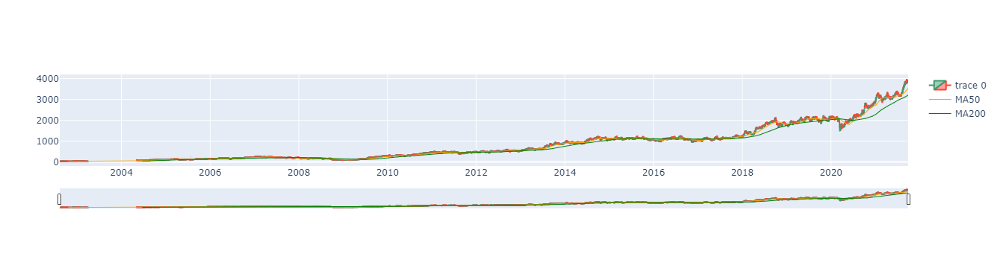

In [ ]:
tcs['MA50'] = tcs['Open'].rolling(50).mean()
tcs['MA200'] = tcs['Open'].rolling(200).mean()
fig = go.Figure(data=[go.Candlestick(x=tcs.Date,
                                     open=tcs.Open, 
                                     high=tcs.High,
                                     low=tcs.Low,
                                     close=tcs.Close), 
                      go.Scatter(x=tcs.Date, y=tcs.MA50, line=dict(color='orange', width=1),name="MA50"),
                      go.Scatter(x=tcs.Date, y=tcs.MA200, line=dict(color='green', width=1),name="MA200")])
fig.show()

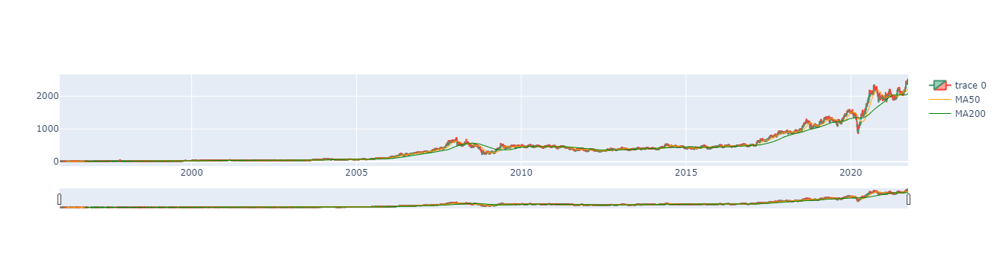

In [ ]:
ril['MA50'] = ril['Open'].rolling(50).mean()
ril['MA200'] = ril['Open'].rolling(200).mean()
fig = go.Figure(data=[go.Candlestick(x=ril.Date,
                                     open=ril.Open, 
                                     high=ril.High,
                                     low=ril.Low,
                                     close=ril.Close), 
                      go.Scatter(x=ril.Date, y=ril.MA50, line=dict(color='orange', width=1),name="MA50"),
                      go.Scatter(x=ril.Date, y=ril.MA200, line=dict(color='green', width=1),name="MA200")])
fig.show()

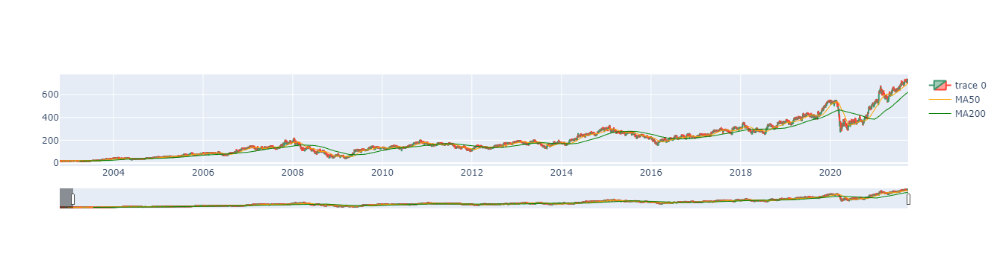

In [ ]:
bank['MA50'] = bank['Open'].rolling(50).mean()
bank['MA200'] = bank['Open'].rolling(200).mean()
fig = go.Figure(data=[go.Candlestick(x=bank.Date,
                                     open=bank.Open, 
                                     high=bank.High,
                                     low=bank.Low,
                                     close=bank.Close), 
                      go.Scatter(x=bank.Date, y=bank.MA50, line=dict(color='orange', width=1),name="MA50"),
                      go.Scatter(x=bank.Date, y=bank.MA200, line=dict(color='green', width=1),name="MA200")])
fig.show()

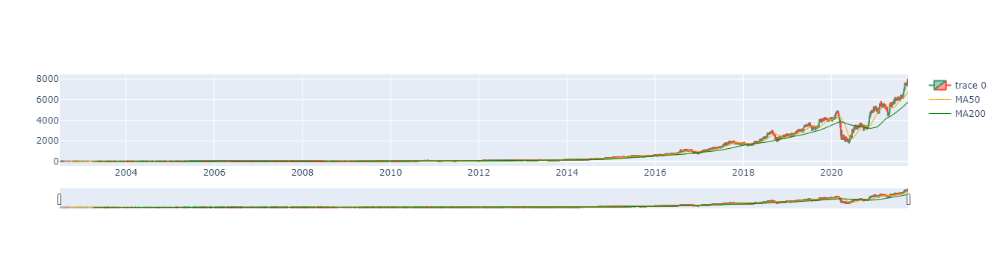

In [ ]:
bajfin['MA50'] = bajfin['Open'].rolling(50).mean()
bajfin['MA200'] = bajfin['Open'].rolling(200).mean()
fig = go.Figure(data=[go.Candlestick(x=bank.Date,
                                     open=bajfin.Open, 
                                     high=bajfin.High,
                                     low=bajfin.Low,
                                     close=bajfin.Close), 
                      go.Scatter(x=bajfin.Date, y=bajfin.MA50, line=dict(color='orange', width=1),name="MA50"),
                      go.Scatter(x=bajfin.Date, y=bajfin.MA200, line=dict(color='green', width=1),name="MA200")])
fig.show()

####  Analysing Share High price during Phase 1 Lockdown(25 March – 14 April) and Phase 2 Lockdown (15 April – 3 May)

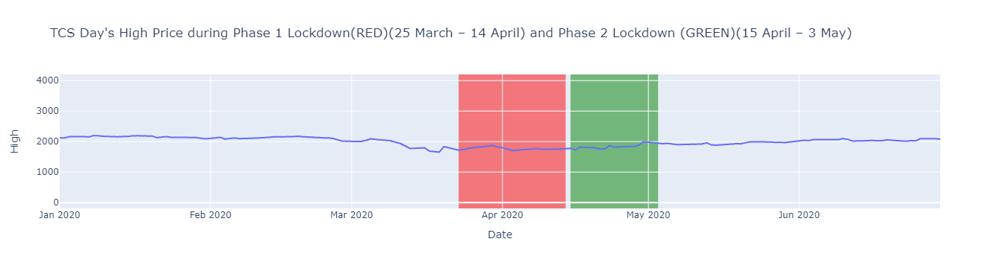

In [ ]:
#Setting the range of base plot
fig = px.line(tcs, x='Date', y='High',title="TCS: Day's High Price during Phase 1 Lockdown(RED)(25 March – 14 April) and Phase 2 Lockdown (GREEN)(15 April – 3 May)", range_x=['2020-01-01','2020-06-30'])

# Adding the shape in the dates
fig.update_layout(
        shapes=[
            # First phase Lockdown
            dict(type="rect",xref="x",yref="paper",x0="2020-03-23",y0=0,x1="2020-04-14",y1=1,fillcolor="Red",opacity=0.5,layer="below",line_width=0,),
            # Second phase Lockdown
            dict(type="rect",xref="x",yref="paper",x0="2020-04-15",y0=0,x1="2020-05-03",y1=1,fillcolor="Green",opacity=0.5,layer="below",line_width=0,)
                ])
fig.show()

#### RIL

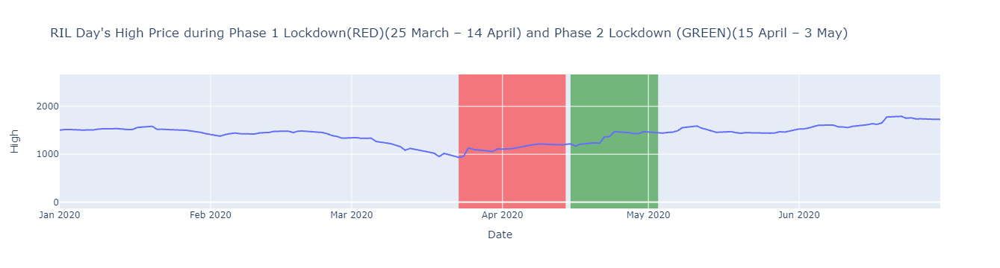

In [ ]:
#Setting the range of base plot
fig = px.line(ril, x='Date', y='High',title="RIL: Day's High Price during Phase 1 Lockdown(RED)(25 March – 14 April) and Phase 2 Lockdown (GREEN)(15 April – 3 May)", range_x=['2020-01-01','2020-06-30'])

# Adding the shape in the dates
fig.update_layout(
        shapes=[
            # First phase Lockdown
            dict(type="rect",xref="x",yref="paper",x0="2020-03-23",y0=0,x1="2020-04-14",y1=1,fillcolor="Red",opacity=0.5,layer="below",line_width=0,),
            # Second phase Lockdown
            dict(type="rect",xref="x",yref="paper",x0="2020-04-15",y0=0,x1="2020-05-03",y1=1,fillcolor="Green",opacity=0.5,layer="below",line_width=0,)
                ])
fig.show()

##### ICICI Bank

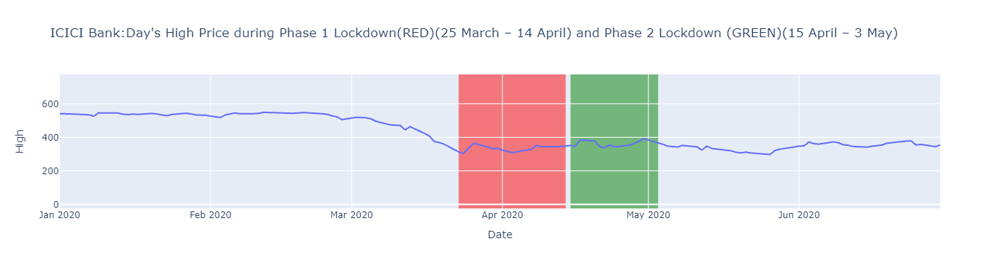

In [ ]:
#Setting the range of base plot
fig = px.line(bank, x='Date', y='High',title="ICICI Bank:Day's High Price during Phase 1 Lockdown(RED)(25 March – 14 April) and Phase 2 Lockdown (GREEN)(15 April – 3 May)", range_x=['2020-01-01','2020-06-30'])

# Adding the shape in the dates
fig.update_layout(
        shapes=[
            # First phase Lockdown
            dict(type="rect",xref="x",yref="paper",x0="2020-03-23",y0=0,x1="2020-04-14",y1=1,fillcolor="Red",opacity=0.5,layer="below",line_width=0,),
            # Second phase Lockdown
            dict(type="rect",xref="x",yref="paper",x0="2020-04-15",y0=0,x1="2020-05-03",y1=1,fillcolor="Green",opacity=0.5,layer="below",line_width=0,)
                ])
fig.show()

#### Bajaj Finserv

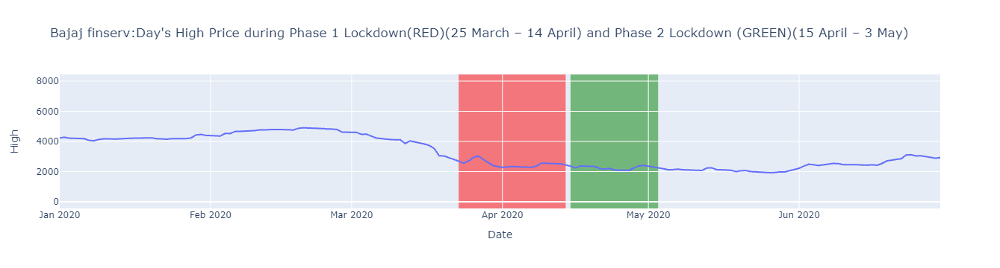

In [ ]:
#Setting the range of base plot
fig = px.line(bajfin, x='Date', y='High',title="Bajaj finserv:Day's High Price during Phase 1 Lockdown(RED)(25 March – 14 April) and Phase 2 Lockdown (GREEN)(15 April – 3 May)", range_x=['2020-01-01','2020-06-30'])

# Adding the shape in the dates
fig.update_layout(
        shapes=[
            # First phase Lockdown
            dict(type="rect",xref="x",yref="paper",x0="2020-03-23",y0=0,x1="2020-04-14",y1=1,fillcolor="Red",opacity=0.5,layer="below",line_width=0,),
            # Second phase Lockdown
            dict(type="rect",xref="x",yref="paper",x0="2020-04-15",y0=0,x1="2020-05-03",y1=1,fillcolor="Green",opacity=0.5,layer="below",line_width=0,)
                ])
fig.show()

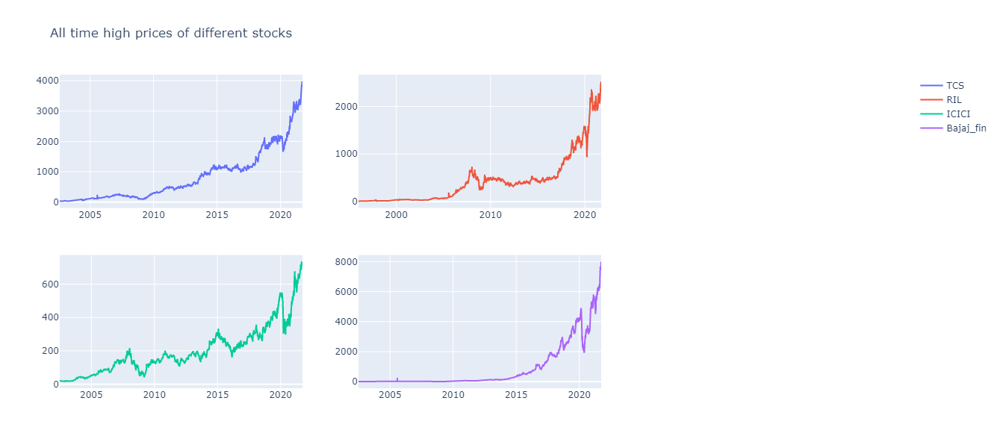

In [ ]:
fig = make_subplots(rows=2, cols=3)
plt.figure
fig.add_trace(
   go.Scatter(y=tcs.High,x=tcs.Date,name="TCS"),
    row=1, col=1
)

fig.add_trace(
    go.Scatter(y=ril.High,x=ril.Date,name="RIL"),
    row=1, col=2
)
fig.add_trace(
    go.Scatter(y=bank.High,x=bank.Date,name="ICICI"),
    row=2, col=1
)
fig.add_trace(
    go.Scatter(y=bajfin.High,x=bajfin.Date,name="Bajaj_fin"),
    row=2,col=2
)


fig.update_layout(height=600, width=900, title_text="All time high prices of different stocks")
fig.show()

In [ ]:
fig = make_subplots(rows=2, cols=3)
plt.figure
fig.add_trace(
   go.Scatter(y=tcs.Low,x=tcs.Date,name="TCS"),
    row=1, col=1
)

fig.add_trace(
    go.Scatter(y=ril.Low,x=ril.Date,name="RIL"),
    row=1, col=2
)
fig.add_trace(
    go.Scatter(y=bank.Low,x=bank.Date,name="ICICI"),
    row=2, col=1
)
fig.add_trace(
    go.Scatter(y=bajfin.Low,x=bajfin.Date,name="Bajaj_fin"),
    row=2,col=2
)


fig.update_layout(height=600, width=900, title_text="All time low prices of different stock")
fig.show()

Intialising Facebook Prophet model


In [ ]:
model=Prophet()

In [ ]:
tcs[["ds","y"]]=tcs[["Date","Close"]]

In [ ]:
model.fit(tcs)

INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


In [ ]:
future = model.make_future_dataframe(periods=365)

In [ ]:
forecast=model.predict(future)

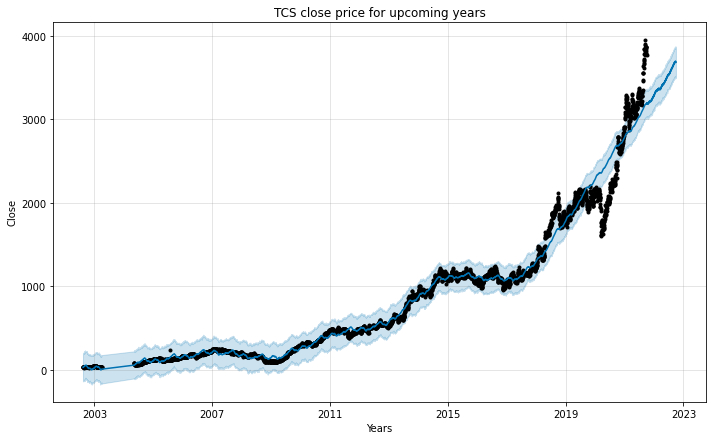

In [ ]:
model.plot(forecast,xlabel="Years",ylabel="Close")
plt.title("TCS close price for upcoming years")
plt.show()

ModuleNotFoundError: ignored